Homework 3 — (15 points)
======
### What to hand in
You are to submit the following things for this homework:
1. A Jupyter notebook containing all code and output (figures and audio). I should be able to evaluate the file to reproduce all output. 
1. Any other data that we tell you to save to a file (e.g. audio files).

Note: Make sure to include all the files that are required for the notebook to run **from the submission folder** (e.g. trumpet.wav). Points will be taken off from submissions that crash because Python cannot find the specified files.

### How to hand it in
To submit your lab:
1. Compress all of the files specified into a .zip file. 
1. Name the file in the following manner, firstname_lastname_hw1.zip. For example, Bryan_Pardo_hw1.zip. 
1. Submit this .zip file via Canvas

## Run this code block 1st, to import the needed packages

In [1]:
# This line is a convenience to import most packages you'll need. You may need to import others (eg random and cmath)
import IPython, numpy as np, scipy as sp, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath,math
from IPython.display import Audio
 
# This line makes sure your plots happen IN the webpage you're building, instead of in separate windows.
%matplotlib inline


# define these functions from previous HWs, useful for testing
def make_sinewave(f, t, sr):
    """    
    Parameters
    ----------
    f:  float
        Frequency of sine wave
    t:  float
        Duration in seconds
    sr: int
        Sample rate
    
    Returns
    -------
    np.ndarray 
        Array of floats containing the signal
    """
    samples = np.arange(0, t*sr)/sr
    
    x = np.sin(2*np.pi*f*samples)
    return x
    
def plot_audio(x, sr, figsize=(16,4)):
    """
    A simple audio plotting function
    
    Parameters
    ----------
    x: np.ndarray
        Audio signal to plot
    sr: int
        Sample rate
    figsize: tuple
        A duple representing the figure size (xdim,ydim)
    """
    length = float(x.shape[0]) / sr
    t = np.linspace(0,length,x.shape[0])
    plt.figure(figsize=figsize)
    plt.plot(t, x)
    plt.ylabel('Amplitude')
    plt.xlabel('Time (s)')
    plt.show()


## Some Helpful Code

In [2]:

from scipy.fftpack import fft
from scipy.signal import hann

def wavwrite(filepath, data, sr, norm=True, dtype='int16',):
    '''
    Write wave file using scipy.io.wavefile.write, converting from a float (-1.0 : 1.0) numpy array to an integer array
    
    Parameters
    ----------
    filepath : str
        The path of the output .wav file
    data : np.array
        The float-type audio array
    sr : int
        The sampling rate
    norm : bool
        If True, normalize the audio to -1.0 to 1.0 before converting integer
    dtype : str
        The output type. Typically leave this at the default of 'int16'.
    '''
    if norm:
        data /= np.max(np.abs(data))
    data = data * np.iinfo(dtype).max
    data = data.astype(dtype)
    sp.io.wavfile.write(filepath, sr, data)
    
#-----------------------------------------------------------
# Here's an stft implementation. Yes, it doesn't bother to get the last little bit of audio.
   
def stft(signal, window_size, hop_size, window_type = 'hann'):
    """
    Computes the short term fourier transform of a 1-D numpy array, where the array 
    is windowed into a set of subarrays, each of length window_size. The distance between
    window centers (in samples) is given by hop_size. The type of window applied is
    determined by window_type. This returns a 2-D numpy array where the ith column
    is the FFT of the ith window. Each column contains an array of complex values.
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    window_type: a string specifying one of two "hann" or "rectangular"
    
    Returns
    -------
    a 2D numpy array of complex numbers where the array column is the FFT of the ith window,
    and the jth element in the ith column is the jth frequency of analysis.
    """
    # figure out how many hops
    length_to_cover_with_hops = len(signal) - window_size;
    assert (length_to_cover_with_hops >= 0), "window_size cannot be longer than the signal to be windowed"
    num_hops = 1 + length_to_cover_with_hops/hop_size;
    
    # make our window function
    if window_type == 'hann':
        window = hann(window_size)
    elif window_type=='rectangular':
        window = np.ones(window_size)
    else:
        raise Exception('Invalid window type. Must be "hann" or "rectangular".')
    
    stft = [0]*num_hops
    # fill the array with values 
    for hop in range(num_hops):
        start = hop*hop_size
        end = start + window_size
        unwindowed_sound = signal[start:end]
        windowed_sound =  unwindowed_sound * window
        stft[hop]= fft(windowed_sound, window_size) 
    return np.array(stft)

#-----------------------------------------------------------
# here's a spectrogram implementation

def spectrogram(signal, window_size, hop_size, sample_rate, window_type = 'hann', display = True ):
    """
    Computes the short term fourier transform of a 1-D numpy array, where the array 
    is windowed into a set of subarrays, each of length window_size. The distance between
    window centers (in samples) is given by hop_size. The type of window applied is
    determined by window_type. This creates a 2-D numpy array where the ith column
    is the FFT of the ith window. Each column contains an array of complex values.
    It then creates a magnitude spectrogram of the signal and plots it on the screen.
    Here, the vertical dimension is frequency (in Hz), the horizontal dimension is time
    (in seconds), brightness corresponds to amplitude (in dB). Only frequencies up to
    the Nyquist rate are displayed.
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    sample_rate: an integer giving the sample rate of the input signal, in Hz
    window_type: a string specifying one of two "hann" or "rectangular"
    display: a bool. If set to True, it plots the spectrogram. Else it does not.
    
    Returns
    -------
    an output tuple with 3 items
    
    sgram:  a 2-D numpy array of real-valued numbers that contains the magnitude spectrogram
           sgram[t,f] is the magnitude at time t and frequency f. This only contains values
           up to the nyquist frequency
    times: a 1-D numpy array of non-negative real-values that gives the times,  
           times[t] gives the start time of the tth window in seconds
    freqs: a 1-D numpy array  of non-negative real values. freqs[f] gives the fth
           frequency of analysis in Hz, up to the nyquist frequency
           
    Calling Example
    ---------------
    sgram,times,freqs = spectrogram(signal, window_size, hop_size, sample_rate )

    """ 

    # get the stft
    X = stft(signal, window_size, hop_size, window_type)

    # figure out what my window start times are
    times = np.arange(len(X))
    hop_in_secs = hop_size/(1.0 * sample_rate)
    times = times * hop_in_secs
    
    # chop off everything above the nyquist rate & rotate for display    
    X = np.rot90(X,3)
    sgram = np.array(X[0:len(X)/2])

    # figure out what my frequencies of analysis are..
    analysis_f0 = sample_rate/window_size
    freqs = np.arange(len(sgram)) * analysis_f0
    
    # turn the complex values into magnitudes and putit into a log scale 
    sgram = np.abs(sgram) + 0.00000000000001  # this prevents taking the log of 0
    log_sgram = 20 * np.log10(sgram)
 
    # plot the spectrum 
    if display: 
        plt.figure()
        x_coord = np.tile(times,(len(freqs),1)) 
        x_coord = np.fliplr(x_coord)
        y_coord = np.tile(freqs,(len(times),1))
        y_coord = np.rot90(y_coord,3)
        
        plt.pcolor(x_coord,y_coord,log_sgram)
        # set the limits of the plot to the limits of the data
        plt.axis([x_coord.min(), x_coord.max(), y_coord.min(), y_coord.max()])

        plt.title('Magnitude Spectrogram in dB')
        plt.xlabel('time in seconds')
        plt.ylabel('frequency in Hz')
        cbar = plt.colorbar()

    return np.rot90(log_sgram,1), times, freqs
#--------------------------------------
# A couple of helper functions to make mels into frequencies and vice versa

def mel2freq(mel):
    freq = 700.0 * (-1.0 + 10.0**(mel/2595.0))
    return freq

def freq2mel(freq):
    x = 1.0 + freq/700.0
    mel = 2595 * np.log10(x)
    return mel

#-----------------------------------------------------------
# Exactly what it says it is...

def make_triangular_filters(cfreqs,freqs,nyquist):
    """
    Computes a set of "filters" to apply to an STFT to change its frequency scaling.
    This takes an array of center frequencies (cfreqs) and a set of frequencies of 
    analysis from your Fourier transform (freqs) as input, both coded in Hz.  It will 
    return a 2-D numpy array filters[c][f], where c is the index number of a center 
    frequency in cfreqs and f is the index to a frequency in freqs and the value in 
    filters[c][f] gives the filter magnitude (a number between 0 and 1 that represents 
    how sensitive this filter is to that frequency). 
    
    Filters are triangular, with a linear decrease in sensitivity from the center 
    frequency (sensitivity = 1) down to a sensitivity of 0 by the center frequency 
    of each adjacent freqency. The lowest center frequency will decrease to 0 by 
    0 Hz on the low end. The highest center frequency will decrease to 0 by the 
    Nyquist frequency on the high end.
    
    Note: you do not have to normalize the filters by energy in this exercise 
    (the maximum magnitude for all filters is equal to 1).
    
    Input Parameters
    ----------------
    cfreqs: a 1-D python array of center frequencies measured in Hz
    freqs:   a 1-D python array of frequencies for whom we need to calculate the sensitivity
             of each filter (also measured in Hz)
    nyquist: the frequency of the nyquist rate. By default, the filter with the highest 
            center frequency will have its response reach 0 at the nyquist frequency. 
    
    Returns
    -------
    filters: a 2-D numpy array, where c is the index number of a center frequency in 
            cfreqs and f is the index to a frequency in freqs and the value in filters[c][f] 
            is a number between 0 and 1 that represents how sensitive this filter is to 
            that frequency.
            
    """
     
    assert min(freqs)<=min(cfreqs) and max(freqs)>=max(cfreqs), "cfreqs range must be within freqs range."

    filters = np.zeros((len(cfreqs), len(freqs)))
        
    for c in range(0,len(cfreqs)):
        if c==0: 
            # if we're on the first cfreq, use 0 for the low frequency
            low_freq = 0 
            high_freq = cfreqs[c+1]
        elif c==(len(cfreqs)-1):
            # if we're on the last cfreq, use nyquist for the high frequency
            low_freq = cfreqs[c-1]
            high_freq = nyquist 
        else:
            low_freq = cfreqs[c-1]
            high_freq = cfreqs[c+1]
  
        for f in range(len(freqs)):
            
            if (freqs[f]> cfreqs[c]):
                x = freqs[f]
                b = -high_freq / float(cfreqs[c]-high_freq) # offset
                a = 1./(cfreqs[c]-high_freq) # slope
                filters[c][f] = max([a*x+b,0.])
                    
            elif (freqs[f]< cfreqs[c]):
                x = freqs[f]
                b = -low_freq / float(cfreqs[c]-low_freq) # offset
                a = 1./(cfreqs[c]-low_freq) # slope
                filters[c][f] = max([a*x+b,0.])
            else:
                filters[c][f] = 1.0
    return filters

#### 1. (2 points) Make a log spectrogram function that lets you use either log2 spacing or mel frequency spacing..  

$m = 2595log_{10}(1+\frac{f}{700})$

(1) Douglas O'Shaughnessy (1987). Speech communication: human and machine. Addison-Wesley. p. 150. ISBN 978-0-201-16520-3.

In [3]:
def log_spectrogram(signal, window_size, hop_size, sample_rate, num_channels, channel_spacing = 'mel', display = True ):
    """
    Builds a mel-frequency spectrogram. Computes the short term fourier transform of a 1-D numpy array 
    (the signal). It then creates a magnitude spectrogram of the signal and then remaps the energy num_channels
    frequency bins, spaced evenly in the log (or mel) frequency domain between the top key of the piano (4186 Hz) and 
    the bottom key of the piano (27.5 Hz). The vertical dimension is the index number of 
    the frequency channel. The horizontal dimension is time(in seconds), brightness corresponds to 
    amplitude (in dB). Only frequencies up to the top of the piano are displayed.
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    sample_rate: an integer giving the sample rate of the input signal, in Hz
    num_channels: how many frequency bins to put the energy into
    channel_spacing: if 'mel', then space evenly in the mel range. Else, evenly in log2(freq)
            *NOTE* if you pick 88 channels and log2 spacing, this places a bin at each piano key
    display: a bool. If set to True, it plots the spectrogram. Else it does not.
    
    Returns
    -------
    an output tuple with 3 items
    
    lgram: a 2-D numpy array of real-valued numbers that contains the magnitude spectrogram.
           lgram[t,f] is the magnitude at time t and frequency f. This only contains values
           up to the pitch note of the piano (4186 Hz)
    times: a 1-D numpy array of non-negative real-values that gives the times,  
           times[t] gives the start time of the tth window in seconds
    freqs: a 1-D numpy array  of non-negative real values. freqs[f] gives the fth
           frequency bin in Hz. These are spaced evenly in the log2 of the frequency in Hz,
           with 12 to an octave. 
           
    Calling Example
    ---------------
    lgram,times,freqs = log_spectrogram(signal, window_size, hop_size, sample_rate, num_channels )

    """ 
    bottom_hz = 27.5
    top_hz = 4186.
    
    #assign our filter center frequencies
    if channel_spacing == 'mel':    
        bottom_mel = freq2mel(bottom_hz)
        top_mel = freq2mel(top_hz)
        cfreqs = np.linspace(bottom_mel, top_mel, num_channels)
        cfreqs = mel2freq(cfreqs)
    else:
        bottom_log = math.log(bottom_hz, 2)
        top_log = math.log(top_hz, 2)
        cfreqs = np.linspace(bottom_log, top_log, num_channels)
        cfreqs = 2**cfreqs

    #no need to do extra work...
    sgram, times, freqs = spectrogram(signal, window_size, hop_size, sample_rate, display=False)
    
    #create filter bank
    nyquist = top_hz
    filters = make_triangular_filters(cfreqs, freqs, nyquist)
    
    #apply filters to create log spectrogram
    lgram = np.zeros((len(times), len(cfreqs)))
    for i in range(len(times)):
        for j in range(len(cfreqs)):
            lgram[i][j] = np.dot(sgram[i], filters[j])
    
    #plot the log spectrogram
    if display:
        plt.figure()
        channels = np.arange(len(cfreqs))
        plt.pcolor(times, channels, lgram.T)
        plt.axis([times.min(), times.max(), channels.min(), channels.max()])

        plt.title('Log Spectrogram (' + channel_spacing + ')')
        plt.xlabel('Time (seconds)')
        plt.ylabel('Frequency Channel Index')
        plt.colorbar().set_label('Magnitude (db)')
        
        plt.show()

    return lgram, times, cfreqs

In [4]:
#load the sine sweep that's provided for us
sweep, sr = librosa.load('sinesweep.wav')
Audio(sweep, rate=sr)
#yay it's good!

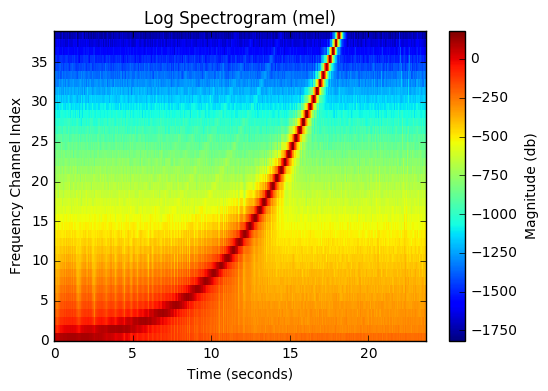

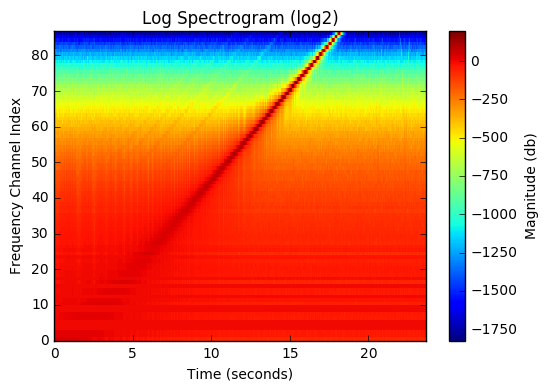

In [5]:
#check our function... is it what we expect? ...
#... mel scale should look slightly exponential and then even out to a linear curve
#... log2 scale should be pretty much linear

lgram, times, freqs = log_spectrogram(sweep, 2048, 1024, sr, 40)
lgram, times, freqs = log_spectrogram(sweep, 2048, 1024, sr, 88, channel_spacing = 'log2')

#whoopee the results look good!

### 2. ( 2 points) Make a chromagram. 

In [6]:
def chromagram(signal, window_size, hop_size, sample_rate, bins_per_pitchclass = 10, display = True):
    """
    Computes a SIMPLE chromagram of the signal and plots it on the screen. By SIMPLE chromagram,
    I mean that each chroma bin only gets energy from frequencies that fall within the width of the bin.
    Another way of putting that is: Only energy around powers of 2 of the same frequencies share a chroma bin.
    Another way of putting that is no energy from odd harmonics placed in a bin. 
    
    Here, the vertical dimension is chroma from 0 to 1 (AKA pitch class put on a scale from 0 to 1), 
    the horizontal dimension is time (in seconds), brightness corresponds to amplitude (in dB).
    
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    sample_rate: an integer giving the sample rate of the input signal, in Hz
    bins_per_pitchclass: a positive integer specifying how many bins each pitchclass will contain
    display: bool. if set to True, it displays the chromagram on the screen
    
    Returns
    -------
    an output tuple with 3 items
    
    cgram:  a 2-D numpy array of real-valued numbers that contains the magnitude chromagram
           cgram[t,c] is the magnitude at time t and chroma c. This only contains values
           up to the nyquist frequency
    times: a 1-D numpy array of non-negative real-values that gives the times,  
           times[t] gives the start time of the tth window in seconds
    chroma: a 1-D numpy array  of non-negative real values in the range 0 to 1. chroma[c] 
            gives the cth chroma bin 
  
    Calling Example
    ---------------
    cgram,times,chroma = chromagram(signal, window_size, hop_size, sample_rate, bins_per_pitchclass)
        
    """
    #set up chroma array
    num_pitch_classes = 12
    num_bins = num_pitch_classes * bins_per_pitchclass
    chroma = np.linspace(0., 1., num_bins, endpoint=False)
    
    #create spectrogram
    sgram, times, freqs = spectrogram(signal, window_size, hop_size, sample_rate, display=False)
    
    #undo the dB amplitude scaling in sgram... 
    #otherwise values are really negative and mask the important positive values that we actually care about
    sgram = 10**(sgram/20)
    
    #create chromagram
    cgram = np.zeros((len(times), num_bins))
    for t in range(len(times)):
        for f in range(len(freqs)):
            freq = freqs[f] + 0.000000000000001 #so we don't take log2 of 0
            c = np.log2(freq) - np.floor(np.log2(freq)) #identify chroma bin
            index = int(c*num_bins)
            cgram[t][index] += sgram[t][f] #sum up amplitudes in each chroma bin
    
    #now scale the amplitude back into dBs
    cgram = 20*np.log10(cgram)
    
    #display with pcolor
    if display:
        plt.figure(figsize=(20,4))
        plt.pcolor(times, chroma, cgram.T)
        plt.axis([times.min(), times.max(), chroma.min(), chroma.max()])
        
        plt.title('Chromagram')
        plt.xlabel('Time (seconds)')
        plt.ylabel('Chroma')
        plt.colorbar().set_label('Magnitude (db)')
        plt.show()

    return cgram,times,chroma

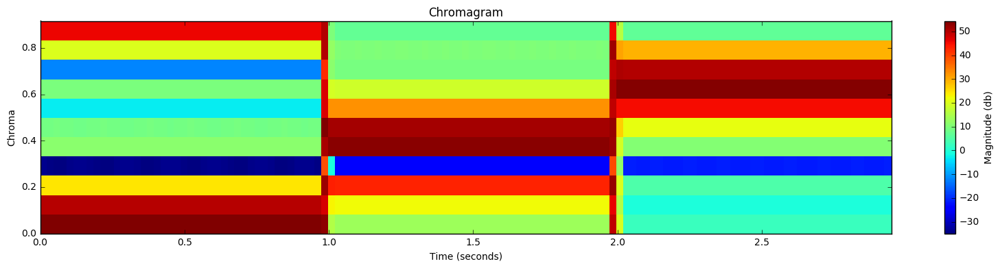

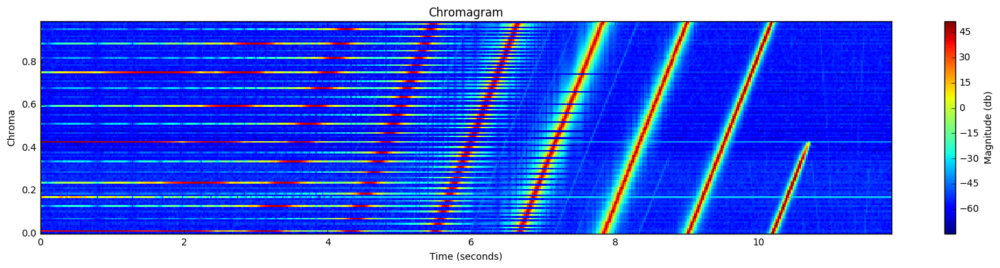

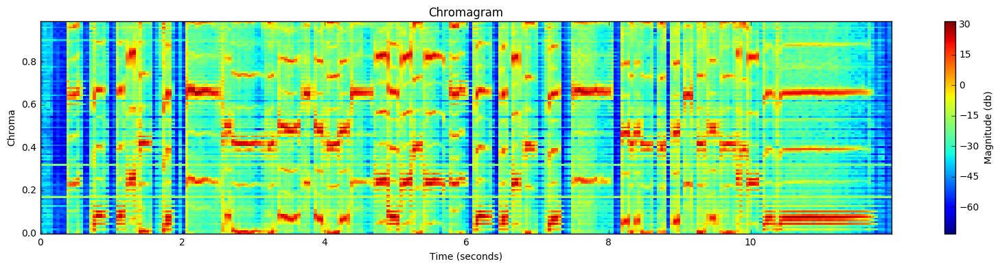

In [7]:
#ok let's test this out...
#first let's just see if it looks good with a simple C -> E -> G progression, with only one bin per pitch class
sr = 44100.
length = 1.
c = make_sinewave(261.63, length, sr)
e = make_sinewave(329.63, length, sr)
g = make_sinewave(392.00, length, sr)
triad = np.concatenate((c, e, g))
cgram, times, chroma = chromagram(triad, 2048, 1024, sr, 1)
#this looks good!
#if you count the half steps, the darkest bars line up right where they should be

#now let's try it on the sine sweep from before... this should just be dark diagonal lines across the graph
cgram, times, chroma = chromagram(sweep, 2048, 1024, sr)
#yeaaaa let's gooo

#and finally let's take it on a test drive with the trumpet.wav recording provided
trumpet, sr = librosa.load('trumpet.wav')
cgram, times, chroma = chromagram(trumpet, 2048, 1024, sr)
Audio(trumpet, rate=sr) #include audio for reference
#this is pretty cool. The red parts are right where they should be

#### 3. (2 point) Make a mel-frequency cepstrogram.  In lecture we mentioned the plain (not mel frequency) cepstrum of a time-domain signal $s$ can be calculated as follows:

$ cepstrum = ifft(log|fft(s)|)$

#### For audio processing, we typically don't use the FFT, but the mel-spectrogram. This means we've removed the frequencies above the Nyquist rate and therefore, things can get a little bit weird when taking the inverse FFT. A very common approach to dealing with this weirdness is to use an alternate transform called the Discrete Cosine Transform (DCT). You don't have to understand the details for this assignment , but you can find out more about cesptrums in the paper reading coming up in the 2nd half of the class.  Anyhow, now the cepstrum looks more like this:

1. Get the spectrum S = fft(s)
2. make a mel-spaced magnitude spectrum M from S, discarding frequencies above Nyquist
3. make M' = log(M)
4. do DCT(M') 

#### This is the approach we'd like you to take in making a mel-frequency cepstrogram. 

#### You can find a DCT implementation to use here:
http://docs.scipy.org/doc/scipy-0.14.0/reference/generated/scipy.fftpack.dct.html


In [8]:
def mf_cepstrogram(signal, window_size, hop_size, sample_rate, num_channels, display = True ):
    """
    Builds a mel-frequency cepstrogram. Computes the short term fourier transform of a 1-D numpy array 
    (the signal). It then creates a magnitude spectrogram of the signal and then remaps the energy num_channels
    frequency bins, spaced evenly in the mel frequency domain between the top key of the piano (4186 Hz) and 
    the bottom key of the piano (27.5 Hz). It then takes the DCT of the log of each magnitude spectrum. The 
    vertical dimension is the index number of the cepstral coefficient. The horizontal dimension is time(in seconds), 
    brightness corresponds to magnitude.
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    sample_rate: an integer giving the sample rate of the input signal, in Hz
    num_channels: how many mel-spaced frequency bins to put the energy into. 
                This becomes the number of cepstral coefficients.
    display: bool. If set to True, it plots the spectrogram. Else it does not.
    
    Returns
    -------
    an output tuple with the following items
    
    mfccgram: a 2-D numpy array of real-valued numbers that contains the mel frequency cepstrogram.
           mfccgram[t,c] is the magnitude at time t and cepstral coefficeint c. 
    times: a 1-D numpy array of non-negative real-values that gives the times,  
           times[t] gives the start time of the tth window in seconds
           
    Calling Example
    ---------------
    mfccgram,times = mf_cepstrogram(signal, window_size, hop_size, sample_rate, num_channels)

    """
    
    #get the mel-frequency, log magnitude spectrogram (log_spectrogram does setps 1-3)
    lgram, times, freqs = log_spectrogram(signal, window_size, hop_size, sample_rate, num_channels, display=True)
    lgram = 10**(lgram/20) #undo the log, we'll take it again later
    mfccgram = np.zeros((lgram.shape[0], lgram.shape[1]))
    
    #do DCT of each time slice (step 4)
    for t in range(len(times)):
        mfccgram[t] = sp.fftpack.dct(np.log(lgram[t] + 0.00000000000000001))
    
    #plot it
    if display:
        TT,FF = np.meshgrid(times, np.arange(mfccgram.shape[1])+1)
        plt.pcolormesh(TT, FF, mfccgram.T)
        plt.axis([TT.min(), TT.max(), FF.min(), FF.max()])
        plt.title('Mel Frequency Cepstrogram')
        plt.xlabel('Time (seconds)')
        plt.ylabel('Cepstrum coefficient index')
        plt.colorbar()
        
        plt.show()
        
    return mfccgram, times

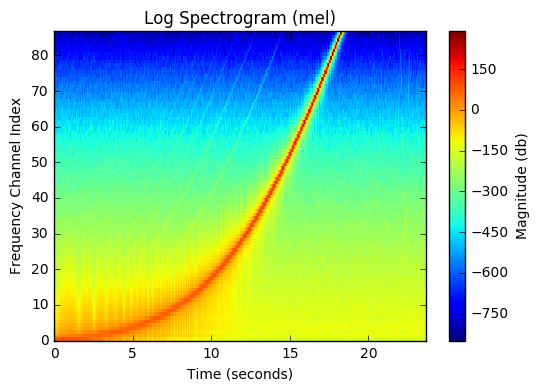

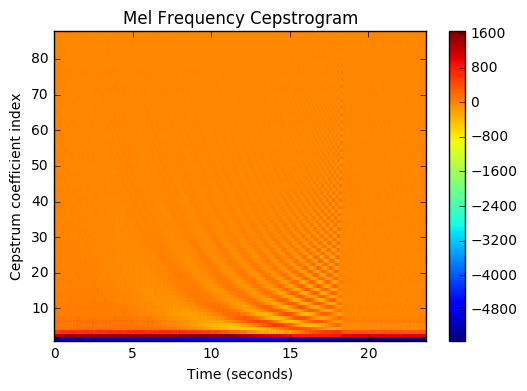

In [9]:
#run it on the sin sweep to see if it's what we expect
mfccgram, times = mf_cepstrogram(sweep, 2048, 1024, sr, 88)
#whoopee it works!

## Starting with Question 4, it is OK to use any function from librosa to do your work.

#### 4. (1 point) The recordings "balloon_center.wav" and "balloon_stage.wav" are of balloon pops recorded in Ryan Auditorium in front of the class. The microphone was placed at the center of the auditorium. For the first recording the balloon was poped very close to the microphone, while for the second one the balloon was poped on the stage, far from the microphone. Assume that the balloon pops were perfect impulses and that the recordings made were perfect recordings of the resulting sound in the room. Explain how to use these recordings to estimate the impulse response of the room. Then add the sound of the auditorium's reverberation to the dry (no reverb) recording "trumpet.wav" using both recordings (we talked about two different methods for filtering a signal in class, use the one with less computational complexity). Listen to the results and discribe any similarities or differences you notice between the two reverbed sounds.

Since we are assuming that the balloon pops were perfect impulses, we can simply add reverb using convolution in the frequency domain. When we record an impulse (the balloon pop), we capture the impulse response of the room. The impulse isn't perfect, but we assume that it is - this makes our much computation easier and more convenient. This recording also includes some noise of course - we ignore this as well.

We take the FFT of each signal and then do the convolution operation in the frequency domain. We then take the IFFT of the convoluted signal in order to create the new signal with reverb.

After listening to the recording with and without reverb added, it's easy to tell the difference between the dry sound and the reverbed sounds - the latter sound much more live and have an echo. The two reverbed sounds also have differences between them. The trumpet_center signal (second one in the Audio track below) has the most echo because the impulse was recorded from the center of the room, where an impulse is most live. The trumpet_stage signal (third one in the Audio track below) has a little elss echo because the stage is slightly more dry, and it sounds a little farther away, because the balloon was popped farther away from the microphone.

In [10]:
#get the recordings
trumpet, sr = librosa.load('trumpet.wav', sr)
balloon_center, sr = librosa.load('ryan_auditorium_recordings/balloon_center.wav', sr)
balloon_stage, sr = librosa.load('ryan_auditorium_recordings/balloon_stage.wav', sr)

#the trumpet signal is going to be much longer so we need to pad the balloon signals before taking the fft
num_zeros = len(trumpet) - len(balloon_center)
balloon_center = np.append(balloon_center, np.zeros(num_zeros))
    
num_zeros = len(trumpet) - len(balloon_stage)
balloon_stage = np.append(balloon_stage, np.zeros(num_zeros))
    
#convolve in the frequency domain
trumpet_fft = sp.fft(trumpet)
balloon_center_fft = sp.fft(balloon_center)
balloon_stage_fft = sp.fft(balloon_stage)

trumpet_center_fft = trumpet_fft * balloon_center_fft
trumpet_stage_fft = trumpet_fft * balloon_stage_fft

trumpet_center = sp.fftpack.ifft(trumpet_center_fft)
trumpet_stage = sp.fftpack.ifft(trumpet_stage_fft)

#concatenate the signals together and listen
signal = np.concatenate((trumpet, np.zeros(2000), trumpet_center, np.zeros(2000), trumpet_stage))
Audio(signal, rate=sr)


/home/mattniemer/miniconda2/envs/eecs352/lib/python2.7/site-packages/IPython/lib/display.py:123: ComplexWarning: Casting complex values to real discards the imaginary part
  data = np.array(data, dtype=float)


#### 5. (1 points) Now explain what possible sources of error there are that might mess up the approach to estimating the auditorium's impulse  response described in Question 4 and how you would go about reducing or eliminating these sources of error in your impulse response estimation.

There are several possible sources of error. There was certainly an air conditioner running in the background, creating a constant level of noise. There's also potentially movement in the room, i.e. someone coughing, typing, or opening a door. These will all contribute to noise. We can attempt to eliminate some of these sources of error by recording many impulses and taking the average. If we assume that the noise is unbiased, hopefully it will wash out when we average the impulse recordings.

#### 6. (2 points)  Below is some code we have provided to estimate the impulse response of the auditorium using the sine sweep we played and recorded. Plot the frequency response function associated with this impulse response function. Plot the frequency response of the impulse response you got using the method in Question 4. Compare them. 

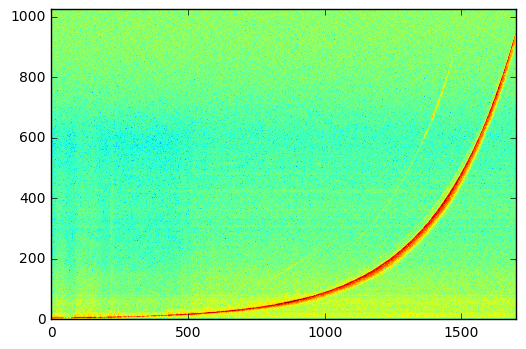

In [11]:
# load the sine sweep played out through the speaker in the auditorium
sine_sweep,sr = librosa.load('sinesweep.wav', 44100)
input_size=np.size(sine_sweep)

# load the recording made of the sine sweep in the auditorium
sine_sweep_recording,sr = librosa.load('ryan_auditorium_recordings/sinesweep_recording.wav', 44100)
output_size=np.size(sine_sweep_recording)

# plot an stft of the sine sweep recorded in the auditorium
plt.figure(); plt.imshow(20*np.log10(np.abs(librosa.stft(sine_sweep_recording))),origin='lower',aspect='auto')

# calculate the response of the inverse filter which will be used to extract the impulse response of the auditorium
# from the sine sweep recording
freq_range=np.linspace(20,20000,input_size)
envelope=freq_range[::-1]**3; 
inv_filt=envelope*sine_sweep[::-1]
inv_filt=inv_filt/max(np.abs(inv_filt))

# compute the minimum number of fft point required for filtering (to avoid cirucular convolution)
nfft=input_size+output_size-1
nfft=int(2**np.ceil(np.log2(nfft)))

# perform inverse filtering in the frequency domian 
inv_filt_fft=np.fft.fft(inv_filt,nfft)
recording_fft=np.fft.fft(sine_sweep_recording,nfft)
freq_response=inv_filt_fft*recording_fft
impulse_response=np.real(np.fft.ifft(freq_response))

# normalize the impulse response obtained through inverse filtering
impulse_response=impulse_response/max(np.abs(impulse_response))

# since the energy of the impulse response is concentrated at a very short duration (it's almost zero elsewhere)
# we need to trim it and extract the non-zero part

threshold=0.005 # this threshold was selected empirically
nonzero_idx=np.nonzero(impulse_response>threshold) 
start=nonzero_idx[0][0] # the first time amplitude passes the threshold 
stop=start+sr  # the effective length of the impulse response seems to be less than one second 

impulse_response=impulse_response[start:stop]



/home/mattniemer/miniconda2/envs/eecs352/lib/python2.7/site-packages/numpy/core/numeric.py:482: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


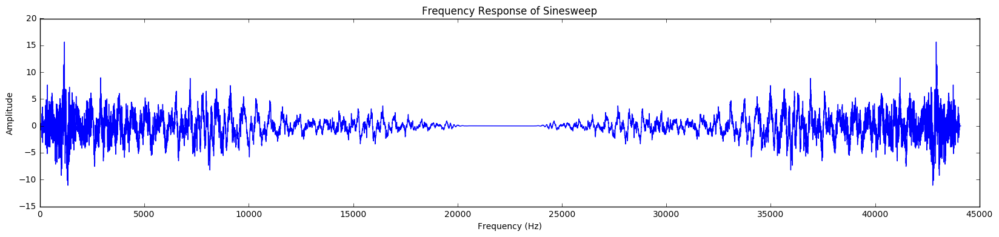

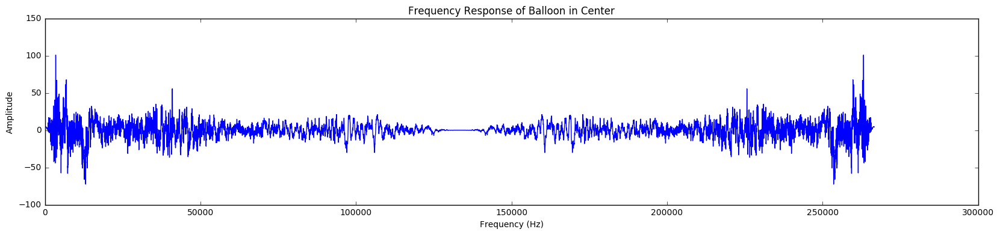

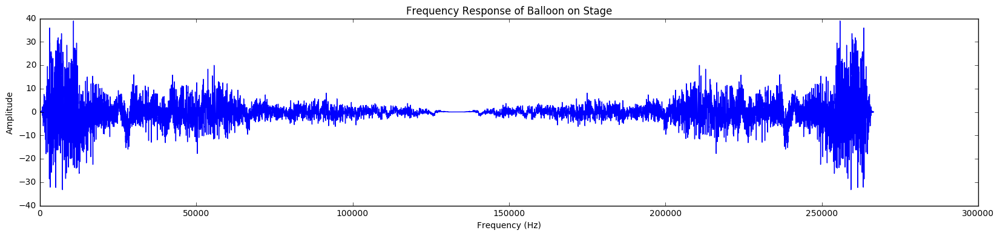

In [12]:
#plot the frequency response of the sinesweep
impulse_response_fft = sp.fft(impulse_response)
plt.figure(figsize=(20,4))
plt.plot(impulse_response_fft)
plt.title('Frequency Response of Sinesweep')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

#plot the frequency response of the balloon in the center
plt.figure(figsize=(20,4))
plt.plot(balloon_center_fft)
plt.title('Frequency Response of Balloon in Center')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

#plot the frequency response of the balloon on the stage
plt.figure(figsize=(20,4))
plt.plot(balloon_stage_fft)
plt.title('Frequency Response of Balloon on Stage')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

There's several differences which are easy to spot. First, the sinesweep frequency response reaches about 22,000 Hz before it is reflected about the middle. The balloons, on the other hand, both top out with frequencies of about 13,000 Hz when they are reflected about the middle. One might think that balloon on the stage has stronger frequencies than the balloon in the center, but that is not the case - the y axis shows us that the balloon in the center has much stronger frequencies than the balloon on the stage. That being said, the balloons do have a very similar shaped frequency response. They both peak early and then once more before diminishing to 0 around 13,000 Hz.

#### 7. (1 points) Use the sine-sweep-derived impulse response to add reverb to "trumpet.wav". Also use the approach you described in Question 4 to add reverb to trumpet.wav. Which sounds better? Listen to the audio file "trumpet_natural_reverb.wav", which was actually recorded in the auditorium and compare it to the reverbed samples you have made using the impulse response of the auditorium. Note...it is ok for this problem to trim an impulse response or trim the trumpet file a touch so that they are the same length. 

In [13]:
#use sine-sweep derived impulse response to add reverb
#this fftconvolve method does the exact same thing but much faster
sin_sweep_trumpet = sp.signal.fftconvolve(trumpet, impulse_response)

#add it to the previous balloon-reverbed signal
#lower the sample rate here because Audio() is acting up... not sure why.
sr = 22050.
signal_compare = np.concatenate((signal, np.zeros(2000), sin_sweep_trumpet))

#order is: dry, balloon in the center, balloon on the stage, sine sweep
Audio(signal_compare, rate=sr)

In [14]:
#get the original sound and play it for comparison
trumpet_original, sr = librosa.load('ryan_auditorium_recordings/trumpet_natural_reverb.wav')
Audio(trumpet_original, rate=sr)

I think that the balloon popped in the center of the auditorium gives creates the reverb which is closest to the reverb in the original recording. This might be for several reasons, but one that comes immediately to mind is that the balloon in the center of the auditorium was closest the microphone. If the trumpet was similarly positioned closely to the microphone in the original recording, then impulses created close to the microphone might better reflect the reverb of the original recording.

However, I find the trumpet with added reverb from the balloon on the stage to be the best sounding sample. It sounds closest to what I would expect to hear when sitting in the audience of an auditorium with someone performing on the stage. The other samples are too live (ballon in center/original), while others (dry/sine-swept) are a bit too dry for my liking. 

#### 8. (1 point) Go on Youtube and listen to the musical piece "I am sitting in a room" by Alvin Lucier. Research the piece on the web. Give your reaction to the piece. Explain how it was created. 

This is monotonous. I'm certainly wouldn't listen to this in my spare time, but I did enjoy the educational experience and what the track demonstrates. the piece was created by recording his voice in a room, and then recursively recording the sound of playing the previous recording back in to the room. This essentially creates the The result is at each iteration, the resonant frequencies of the room dominate the signal more and more until the speech is unintelligble.

#### 9. (2 points) Recreate Alvin Lucier's piece by recording your voice saying the text of the piece ONCE. Then repeatedly use an impulse response function (you can choose any of the provided impulse responses) applied to the signal, duplicating the effect of Lucier's piece without having to keep re-recording in the physical world. NOTE you may have issues to deal with in terms of normalization or length of impulse response function vs length of the recording. You're going to have to figure out those out. 

In [15]:
sr = 44100.
room, sr = librosa.load('sitting_in_a_room.wav', sr)
curr_room = room
Audio(curr_room, rate=sr)
#IPyhon.display.Audio() is giving me trouble... it won't play the audio back to back when I concatenate the signals
#my workaround is to just make several cells and then play the new Audio.
#below is what I would have done, this would have concatenated the signals back to back
#and is also much more succinct than creating many cells
#thanks for your understanding!
#
#for i in range(6):
#    curr_room = sp.signal.fftconvolve(curr_room, impulse_response)
#    room = np.concatenate((room, np.zeros(2000), curr_room))
#   
#Audio(room, rate=sr)

In [16]:
curr_room = sp.signal.fftconvolve(curr_room, impulse_response)
Audio(curr_room, rate=sr)

In [17]:
curr_room = sp.signal.fftconvolve(curr_room, impulse_response)
Audio(curr_room, rate=sr)

In [18]:
curr_room = sp.signal.fftconvolve(curr_room, impulse_response)
Audio(curr_room, rate=sr)

In [19]:
curr_room = sp.signal.fftconvolve(curr_room, impulse_response)
Audio(curr_room, rate=sr)

In [20]:
curr_room = sp.signal.fftconvolve(curr_room, impulse_response)
Audio(curr_room, rate=sr)

#### 10. (1 point) Pick one paper (your choice) from the list of papers on the course home page. Give a 300 word review of the paper. What is the paper about? What did you learn? What was confusing? What was interesting?

I chose to get ahead of the game and read about REPET. REPET, short for Repeating Pattern Extraction Technique, is an algorithm that takes advantage of common musical structure in order to achieve background and voice separation in music. It works in 3 stages. The first stage identifies repeating periods in a piece of music, the second models the repeating segment, and the third extracts these repeating patterns from the music. The beauty of REPET is in how it parallels human psychology – the algorithm is not very complex, but instead is built upon the idea that human auditory senses depend strongly on repetition in signals to differentiate between sources. REPET works the same way. It identifies repeating segments and uses them to distinguish a voice from the background.

By reading the paper, I gained a greater understanding than what I obtained in class. I now have a good sense of not only how REPET works, but why. For example, I now understand that autocorrelation is useful because periodic signals will have a periodic autocorrelation function as lag increases. It was most interesting to read about how REPET stacks up against other competitive music/voice separation algorithms. I'd be interested to learn more about how those methods work and see if even greater results could be achieved by combining methods and creating a hybrid algorithm.

I also enjoyed reading about the limitations of REPET. I had wondered in class about how it functioned on a song with a bridge or chorus in which the background changes chords or rhythm. The extended REPET procedure which windows songs into different local sections seems like a good way to apply the algorithm to a song with different melodic subsections. However, I still wonder if REPET can be made to perform with a piece which contains no repeating background at all.